In [1]:
import mne
import numpy as np
import matplotlib.pyplot as plt

In [2]:
sbj='005'
rec='03'
edf_loc= '/media/biraj/DATA/Motor Imagery Dataset/S'+sbj+'/S'+sbj+'R'+rec+'.edf'
Data = mne.io.read_raw_edf(edf_loc, preload = True)
events, event_id=mne.events_from_annotations(Data)
epochs=mne.Epochs(Data, events, event_id, tmin=0, tmax=4, baseline=(None,None))

Extracting EDF parameters from /media/biraj/DATA/Motor Imagery Dataset/S005/S005R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Used Annotations descriptions: ['T0', 'T1', 'T2']
30 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated


In [3]:
onset = []
duration = [4.1*3]*14
description = []

for i in range(len(events)-1):
    if events[i, 2] == 1:
        continue
    elif events[i, 2] == 2:
        print(events[i-1][0])
        onset.append(events[i-1][0])
        #duration.append(events[i+1][0]-events[i-1][0])
        description.append('T1')
        continue
    elif events[i, 2] == 3:
        print(events[i-1][0])
        onset.append(events[i-1][0])
        #duration.append(events[i+1][0]-events[i-1][0])
        description.append('T2')
        continue

0
1312
2624
3936
5248
6560
7872
9184
10496
11808
13120
14432
15744
17056


In [4]:
montage = mne.channels.make_standard_montage('standard_1020')
Data.rename_channels(lambda x: x.strip('.'))

<RawEDF | S005R03.edf, 64 x 19680 (123.0 s), ~9.7 MB, data loaded>

In [5]:
ch_map = {'Fc5': 'FC5',
          'Fc3': 'FC3',
          'Fc1': 'FC1',
          'Fcz': 'FCz',
          'Fc2': 'FC2',
          'Fc4': 'FC4',
          'Fc6': 'FC6',
          'Cp5': 'CP5',
          'Cp3': 'CP3',
          'Cp1': 'CP1',
          'Cpz': 'CPz',
          'Cp2': 'CP2',
          'Cp4': 'CP4',
          'Cp6': 'CP6',
          'Af7': 'AF7',
          'Af3': 'AF3',
          'Afz': 'AFz',
          'Af4': 'AF4',
          'Af8': 'AF8',
          'Ft7': 'FT7',
          'Ft8': 'FT8',
          'Tp7': 'TP7',
          'Tp8': 'TP8',
          'Po7': 'PO7',
          'Po3': 'PO3',
          'Poz': 'POz',
          'Po4': 'PO4',
          'Po8': 'PO8'}

In [6]:
Data.rename_channels(ch_map)

<RawEDF | S005R03.edf, 64 x 19680 (123.0 s), ~9.7 MB, data loaded>

In [7]:
Data.set_montage(montage)

<RawEDF | S005R03.edf, 64 x 19680 (123.0 s), ~9.8 MB, data loaded>

#include ={'Fp1','Fpz', 'Fp2','FC1','FCz','FC2','C1','Cz','C2','CP1','CPz','CP2'}
include ={'Fp1', 'Fp2','AF3','AF4','AF7','AF8',
          'FC1','FC2','FC3','FC4','FC5','FC6',
          'C1','C2','C3','C4','C5','C6',
          'CP1','CP2','CP3','CP4','CP5','CP6'}

picks=mne.pick_channels(Data.ch_names, include, ordered=True)

In [8]:
print(onset)
print(np.array(onset)/160)
print(np.array(duration))

[0, 1312, 2624, 3936, 5248, 6560, 7872, 9184, 10496, 11808, 13120, 14432, 15744, 17056]
[  0.    8.2  16.4  24.6  32.8  41.   49.2  57.4  65.6  73.8  82.   90.2
  98.4 106.6]
[12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3 12.3]


In [9]:
onset = np.array(onset)/160
duration = np.array(duration)/160
my_ann = mne.Annotations(onset, duration, description)
print(my_ann)

<Annotations | 14 segments: T1 (7), T2 (7)>


In [10]:
Data.set_annotations(my_ann)

<RawEDF | S005R03.edf, 64 x 19680 (123.0 s), ~9.8 MB, data loaded>

In [11]:
csd = mne.preprocessing.compute_current_source_density(Data,lambda2 = 1e-04, stiffness = 4)

Fitted sphere radius:         91.6 mm
Origin head coordinates:      1.0 7.1 49.3 mm
Origin device coordinates:    1.0 7.1 49.3 mm


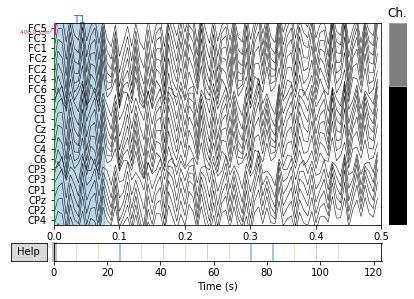

In [12]:
csd.plot(duration=0.5);

In [13]:
Data=csd

In [14]:
events, event_id=mne.events_from_annotations(Data)
epochs=mne.Epochs(Data, events, event_id=event_id, tmin=0, tmax=12, baseline=(None,None))
#epochs=mne.Epochs(Data, events, event_id=event_id, tmin=0, tmax=12, picks=picks, baseline=(None,None))

Used Annotations descriptions: ['T1', 'T2']
14 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated


In [15]:
epochs.info

<Info | 9 non-empty values
 bads: []
 ch_names: FC5, FC3, FC1, FCz, FC2, FC4, FC6, C5, C3, C1, Cz, C2, C4, C6, ...
 chs: 64 CSD
 custom_ref_applied: True
 dig: 67 items (3 Cardinal, 64 EEG)
 highpass: 0.0 Hz
 lowpass: 80.0 Hz
 meas_date: 2009-08-12 16:15:00 UTC
 nchan: 64
 projs: []
 sfreq: 160.0 Hz
>

In [16]:
T1=epochs['T1'].get_data()
T2=epochs['T2'].get_data()

Loading data for 7 events and 1921 original time points ...
0 bad epochs dropped
Loading data for 7 events and 1921 original time points ...
0 bad epochs dropped


In [17]:
import networkx as nx

In [18]:
epochs.ch_names

['FC5',
 'FC3',
 'FC1',
 'FCz',
 'FC2',
 'FC4',
 'FC6',
 'C5',
 'C3',
 'C1',
 'Cz',
 'C2',
 'C4',
 'C6',
 'CP5',
 'CP3',
 'CP1',
 'CPz',
 'CP2',
 'CP4',
 'CP6',
 'Fp1',
 'Fpz',
 'Fp2',
 'AF7',
 'AF3',
 'AFz',
 'AF4',
 'AF8',
 'F7',
 'F5',
 'F3',
 'F1',
 'Fz',
 'F2',
 'F4',
 'F6',
 'F8',
 'FT7',
 'FT8',
 'T7',
 'T8',
 'T9',
 'T10',
 'TP7',
 'TP8',
 'P7',
 'P5',
 'P3',
 'P1',
 'Pz',
 'P2',
 'P4',
 'P6',
 'P8',
 'PO7',
 'PO3',
 'POz',
 'PO4',
 'PO8',
 'O1',
 'Oz',
 'O2',
 'Iz']

In [19]:
info = Data.info
from scipy.signal import hilbert as ht

In [20]:
T1.shape

(7, 64, 1921)

In [21]:
HT = ht(T1[1])

In [22]:
HT[1]

array([-0.00656821-0.00375j   ,  0.00964408-0.00567206j,
       -0.00010954+0.01006491j, ..., -0.00709693+0.00376458j,
       -0.0007253 -0.00945368j,  0.00475657+0.00347189j])

In [23]:
phs = np.angle(HT)
phs[1,1]
plv = np.zeros((64,64,1921))

In [25]:
count = 0;
c = -1;
for t in range(3*160,7*160):
    for ch in range(1,64):
        for ch2 in range(ch+1,64):
            #print(ch,ch2);
            inst_phasediff = np.absolute(phs[ch,t]-phs[ch2,t]);
            #print(inst_phasediff)
            plv[ch,ch2,t] = np.exp(c*inst_phasediff)
            print(t/160);

3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0
3.0


3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625


3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625
3.00625


3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125
3.0125

3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875


3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875
3.01875


3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.025
3.02

3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125
3.03125


3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375

3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375
3.0375

3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375
3.04375


3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05
3.05


3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625
3.05625


3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625

3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625
3.0625

3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875
3.06875


3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.07

3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.075
3.07

3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125
3.08125


3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875
3.0875

3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375


3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375
3.09375


3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1
3.1


3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625
3.10625


3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125

3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125
3.1125

3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875
3.11875


3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.125
3.12

3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125


3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125
3.13125


3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375
3.1375

3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375


3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375
3.14375


3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15
3.15


3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625
3.15625


3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625

3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625
3.1625

3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875
3.16875


3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.175
3.17

3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125


3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125
3.18125


3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875
3.1875

3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375


3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375
3.19375


3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625


3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625
3.20625


3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125

3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125
3.2125

3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875
3.21875


3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.225
3.22

3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125


3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125
3.23125


3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375

3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.2375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3

3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375
3.24375


3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25
3.25


3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625


3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625
3.25625


3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625

3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.2625
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.268

3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875
3.26875


3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.275
3.27

3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125


3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125
3.28125


3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875
3.2875

3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375


3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375
3.29375


3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.3
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625


3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625
3.30625


3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125

3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.3125
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.

3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875
3.31875


3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.325
3.32

3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125


3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125
3.33125


3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375

3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.3375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.3

3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375
3.34375


3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35
3.35


3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625


3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.35625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3

3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625
3.3625

3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875
3.36875


3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.375
3.37

3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125


3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125
3.38125


3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875
3.3875

3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375


3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.39375
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4


3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.4
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625


3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625
3.40625


3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125
3.4125

3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875


3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875
3.41875


3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.425
3.42

3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125
3.43125


3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375
3.4375

3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375


3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375
3.44375


3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45
3.45


3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625
3.45625


3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625

3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625
3.4625

3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875
3.46875


3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.475
3.47

3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125


3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125
3.48125


3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875
3.4875

3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375
3.49375


3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5
3.5


3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625


3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625
3.50625


3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125
3.5125

3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875


3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875
3.51875


3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.525
3.52

3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125


3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.53125
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375


3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375
3.5375

3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375
3.54375


3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55
3.55


3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625


3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625
3.55625


3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625
3.5625

3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875
3.56875


3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.57

3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.575
3.57

3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125
3.58125


3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875
3.5875

3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375


3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375
3.59375


3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6
3.6


3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625
3.60625


3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125
3.6125

3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875
3.61875


3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.625
3.62

3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125


3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125
3.63125


3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375
3.6375

3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375
3.64375


3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65
3.65


3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625


3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625
3.65625


3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625
3.6625

3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875


3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875
3.66875


3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.675
3.67

3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125
3.68125


3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875

3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875
3.6875

3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375
3.69375


3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7
3.7


3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625
3.70625


3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125

3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125
3.7125

3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875
3.71875


3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.72

3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.725
3.72

3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125
3.73125


3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375

3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375
3.7375

3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375
3.74375


3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75
3.75


3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625


3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625
3.75625


3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625
3.7625

3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875


3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875
3.76875


3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.775
3.77

3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125


3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.78125
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3

3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875
3.7875

3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375


3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375
3.79375


3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625


3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625
3.80625


3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125
3.8125

3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875


3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875
3.81875


3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.825
3.82

3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125
3.83125


3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375

3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375
3.8375

3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375
3.84375


3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85
3.85


3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625


3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.85625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.86

3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625
3.8625

3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875


3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875
3.86875


3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.875
3.87

3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125


3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125
3.88125


3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875
3.8875

3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375


3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375
3.89375


3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9
3.9


3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625
3.90625


3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125

3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125
3.9125

3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875
3.91875


3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.925
3.92

3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125


3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125
3.93125


3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375
3.9375

3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375
3.94375


3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95
3.95


3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625


3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625
3.95625


3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625
3.9625

3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875
3.96875


3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.97

3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.975
3.97

3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125
3.98125


3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875
3.9875

3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375


3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
3.99375
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0


4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625


4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625
4.00625


4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125
4.0125

4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875


4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875
4.01875


4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.025
4.02

4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125


4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125
4.03125


4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375
4.0375

4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375
4.04375


4.04375
4.04375
4.04375
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4

4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05
4.05


4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625
4.05625


4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625
4.0625

4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875


4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875
4.06875


4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.075
4.07

4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125
4.08125


4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875

4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875
4.0875

4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375
4.09375


4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1
4.1


4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625


4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625
4.10625


4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125
4.1125

4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875
4.11875


4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.125
4.12

4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125


4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125
4.13125


4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375

4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.1375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.

4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375
4.14375


4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15
4.15


4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625


4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625
4.15625


4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625
4.1625

4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875


4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.16875
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.

4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.175
4.17

4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125
4.18125


4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875

4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875
4.1875

4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375
4.19375


4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2
4.2


4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625


4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625
4.20625


4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125
4.2125

4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875


4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875
4.21875


4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.225
4.22

4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125


4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125
4.23125


4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375
4.2375

4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375


4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375
4.24375


4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25
4.25


4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625
4.25625


4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625

4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625
4.2625

4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875
4.26875


4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.275
4.27

4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125


4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125
4.28125


4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875
4.2875

4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375


4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375
4.29375


4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.3
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30

4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625
4.30625


4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125

4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125
4.3125

4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875
4.31875


4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.32

4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.325
4.32

4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125
4.33125


4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375

4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375
4.3375

4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375
4.34375


4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35
4.35


4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625


4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625
4.35625


4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625
4.3625

4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875
4.36875


4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.375
4.37

4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125


4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125
4.38125


4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875

4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.3875
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.

4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375
4.39375


4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4
4.4


4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625
4.40625


4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125

4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.4125
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.

4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875
4.41875


4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.425
4.42

4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125


4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.43125
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.437

4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.4375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375


4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375
4.44375


4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45
4.45


4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625
4.45625


4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625

4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625
4.4625

4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875
4.46875


4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.475
4.47

4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125


4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125
4.48125


4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875
4.4875

4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375
4.49375


4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5
4.5


4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625


4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625
4.50625


4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125
4.5125

4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875


4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875
4.51875


4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.525
4.52

4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125
4.53125


4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375

4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375
4.5375

4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375
4.54375


4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55
4.55


4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625


4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.55625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625

4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625
4.5625

4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875
4.56875


4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.57

4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.575
4.57

4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125
4.58125


4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875

4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875
4.5875

4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375
4.59375


4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6
4.6


4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625


4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625
4.60625


4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125
4.6125

4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875


4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875
4.61875


4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.625
4.62

4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125
4.63125


4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375

4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375
4.6375

4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375
4.64375


4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65
4.65


4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625


4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.65625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4

4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625
4.6625

4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875
4.66875


4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.67

4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.675
4.67

4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125
4.68125


4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875
4.6875

4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375


4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375
4.69375


4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.7
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625


4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625
4.70625


4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125

4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125
4.7125

4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875
4.71875


4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.725
4.72

4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125


4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125
4.73125


4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375
4.7375

4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375


4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375
4.74375


4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75
4.75


4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625
4.75625


4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625
4.7625

4.7625
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4

4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875
4.76875


4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.775
4.77

4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125


4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.78125
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.787

4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875
4.7875

4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375
4.79375


4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8
4.8


4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625


4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.80625
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8

4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125
4.8125

4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875


4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875
4.81875


4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.825
4.82

4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125


4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.83125
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8

4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375
4.8375

4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375
4.84375


4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85
4.85


4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625
4.85625


4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625

4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625
4.8625

4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875
4.86875


4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.875
4.87

4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125


4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125
4.88125


4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875
4.8875

4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375


4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.89375
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9
4.9


4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625


4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625
4.90625


4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125
4.9125

4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875
4.91875


4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.92

4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.925
4.92

4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125
4.93125


4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375

4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375
4.9375

4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375
4.94375


4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95
4.95


4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625


4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.95625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.

4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625
4.9625

4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875
4.96875


4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.975
4.97

4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125


4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125
4.98125


4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875
4.9875

4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375


4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375
4.99375


5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0
5.0


5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625
5.00625


5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125

5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125
5.0125

5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875


5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.01875
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.025
5.

5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125


5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125
5.03125


5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375
5.0375

5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375


5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375
5.04375


5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625


5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625
5.05625


5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625

5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.0625
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.

5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875
5.06875


5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.075
5.07

5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125
5.08125


5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875

5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875
5.0875

5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375
5.09375


5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1
5.1


5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625
5.10625


5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125

5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125
5.1125

5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875
5.11875


5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.125
5.12

5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125


5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125
5.13125


5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375
5.1375

5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375
5.14375


5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15
5.15


5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625


5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625
5.15625


5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625
5.1625

5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875
5.16875


5.16875
5.16875
5.16875
5.16875
5.16875
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175


5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.175
5.17

5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125
5.18125


5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875
5.1875

5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375


5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375
5.19375


5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625


5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625
5.20625


5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125
5.2125

5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875


5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.21875
5.225
5.225
5.22

5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.225
5.22

5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125
5.23125


5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375

5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375
5.2375

5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375


5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375
5.24375


5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625


5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625
5.25625


5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625

5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.2625
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.2687

5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875
5.26875


5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.275
5.27

5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125


5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125
5.28125


5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875
5.2875

5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375


5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375
5.29375


5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3
5.3


5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625
5.30625


5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125

5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125
5.3125

5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875
5.31875


5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.32

5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.325
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.

5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125
5.33125


5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375

5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.3375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34

5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375
5.34375


5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35
5.35


5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625
5.35625


5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625

5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625
5.3625

5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875
5.36875


5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.375
5.37

5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125


5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125
5.38125


5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875
5.3875

5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375
5.39375


5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4
5.4


5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625


5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625
5.40625


5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125
5.4125

5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875
5.41875


5.41875
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.425
5.

5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125


5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125
5.43125


5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375

5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.4375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.4437

5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375
5.44375


5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45
5.45


5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625


5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625
5.45625


5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625
5.4625

5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875
5.46875


5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.475
5.47

5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125


5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125
5.48125


5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875
5.4875

5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375


5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.49375
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5
5.5


5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625


5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625
5.50625


5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125
5.5125

5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875
5.51875


5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.525
5.52

5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125


5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125
5.53125


5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375
5.5375

5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375


5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375
5.54375


5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55
5.55


5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625
5.55625


5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625

5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625
5.5625

5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875
5.56875


5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.575
5.57

5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125


5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125
5.58125


5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875
5.5875

5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375


5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375
5.59375


5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6
5.6


5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625
5.60625


5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.6125

5.6125
5.6125
5.6125
5.6125
5.6125
5.6125
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.6187

5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875
5.61875


5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.625
5.62

5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125


5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125
5.63125


5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375
5.6375

5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375


5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.64375
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5

5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.6562

5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625
5.65625


5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625

5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.6625
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875

5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875
5.66875


5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.675
5.67

5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125


5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.68125
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875

5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875
5.6875

5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375
5.69375


5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7
5.7


5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625
5.70625


5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125
5.7125

5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875


5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875
5.71875


5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.725
5.72

5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125
5.73125


5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375

5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.7375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375

5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375
5.74375


5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75
5.75


5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625
5.75625


5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625

5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625
5.7625

5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875
5.76875


5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.775
5.77

5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125


5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125
5.78125


5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875
5.7875

5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375


5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375
5.79375


5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.8
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625


5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625
5.80625


5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125
5.8125

5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875


5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875
5.81875


5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.825
5.82

5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125
5.83125


5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375

5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375
5.8375

5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375
5.84375


5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85
5.85


5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625


5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625
5.85625


5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625
5.8625

5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875
5.86875


5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.87

5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.875
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88

5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125
5.88125


5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875
5.8875

5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375


5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375
5.89375


5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9
5.9


5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625
5.90625


5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125

5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.9125
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.9

5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875
5.91875


5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.925
5.92

5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125


5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125
5.93125


5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375

5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.9375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.9437

5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375
5.94375


5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95
5.95


5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625


5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625
5.95625


5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625
5.9625

5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875


5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875
5.96875


5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.975
5.97

5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125


5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125
5.98125


5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875
5.9875

5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375


5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375
5.99375


6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625


6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625
6.00625


6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125
6.0125

6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875


6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875
6.01875


6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.025
6.02

6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125


6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.03125
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375


6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.0375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04

6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375
6.04375


6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05
6.05


6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625
6.05625


6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625
6.0625

6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875


6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875
6.06875


6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.075
6.07

6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125
6.08125


6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875

6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875
6.0875

6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375
6.09375


6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1
6.1


6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625


6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625
6.10625


6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125
6.1125

6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875


6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875
6.11875


6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.125
6.12

6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125


6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.13125
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.13

6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375
6.1375

6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375
6.14375


6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15
6.15


6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625


6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625
6.15625


6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625
6.1625

6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875


6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875
6.16875


6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.175
6.17

6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125


6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125
6.18125


6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875
6.1875

6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375


6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375
6.19375


6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2
6.2


6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625
6.20625


6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125

6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125
6.2125

6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875
6.21875


6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.22

6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.225
6.22

6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125
6.23125


6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375

6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.2375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24

6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375
6.24375


6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25
6.25


6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625
6.25625


6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625

6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625
6.2625

6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875
6.26875


6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.275
6.27

6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125


6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125
6.28125


6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875
6.2875

6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375


6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375
6.29375


6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3
6.3


6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625
6.30625


6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125
6.3125

6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875


6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875
6.31875


6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.325
6.32

6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125


6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.33125
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375


6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375
6.3375

6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375
6.34375


6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35
6.35


6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625
6.35625


6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625

6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625
6.3625

6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875
6.36875


6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.37

6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.375
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.

6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125
6.38125


6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875
6.3875

6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375


6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375
6.39375


6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4
6.4


6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625
6.40625


6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125
6.4125

6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875


6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875
6.41875


6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.425
6.42

6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125


6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125
6.43125


6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375
6.4375

6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375
6.44375


6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45
6.45


6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625


6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625
6.45625


6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625
6.4625

6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875
6.46875


6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.47

6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.475
6.47

6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125
6.48125


6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875

6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.4875
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6

6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375
6.49375


6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5
6.5


6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625
6.50625


6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125
6.5125

6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875


6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875
6.51875


6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.525
6.52

6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125
6.53125


6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375

6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375
6.5375

6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375
6.54375


6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55
6.55


6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625


6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.55625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625


6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625
6.5625

6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875
6.56875


6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.57

6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.575
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125


6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125
6.58125


6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875
6.5875

6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375


6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375
6.59375


6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.6
6.60625
6.60625
6.60625
6.60

6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625
6.60625


6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125
6.6125

6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875


6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875
6.61875


6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.625
6.62

6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125
6.63125


6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375

6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375
6.6375

6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375
6.64375


6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65
6.65


6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625
6.65625


6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625

6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625
6.6625

6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875
6.66875


6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.67

6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.675
6.67

6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125
6.68125


6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875

6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.6875
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375

6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375
6.69375


6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7
6.7


6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625
6.70625


6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125

6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125
6.7125

6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875
6.71875


6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.725
6.72

6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125


6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125
6.73125


6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375
6.7375

6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375


6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.74375
6.75
6.75
6.75
6.75
6.75
6.75
6.75
6.75
6.75
6.75
6.75
6.75
6.75

6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625


6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625
6.75625


6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625
6.7625

6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875


6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.76875
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.77

6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.775
6.77

6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125
6.78125


6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875

6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875
6.7875

6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375
6.79375


6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8
6.8


6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625
6.80625


6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125
6.8125

6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875


6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.81875
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.82

6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.825
6.82

6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125
6.83125


6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375
6.8375

6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375


6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375
6.84375


6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625


6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625
6.85625


6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625
6.8625

6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875


6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875
6.86875


6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.875
6.87

6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125


6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125
6.88125


6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875
6.8875

6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375


6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375
6.89375


6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.9
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90

6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625
6.90625


6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125

6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125
6.9125

6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875
6.91875


6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.925
6.92

6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125


6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125
6.93125


6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375
6.9375

6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375


6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.94375
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.9

6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.956

6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625
6.95625


6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625

6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625
6.9625

6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875
6.96875


6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.975
6.97

6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125


6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125
6.98125


6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875

6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.9875
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6

6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375
6.99375


In [ ]:
plv.shape

In [67]:
np.absolute(np.exp(-1*0.44))

0.6440364210831414

In [68]:
plv[:,:,3]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [61]:
freqs

[array([4.])]

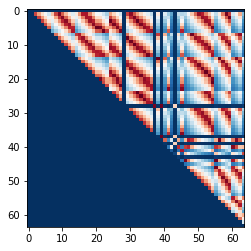

In [26]:
plt.imshow(plv[:,:,5*160],cmap = 'RdBu_r')

In [27]:
from scipy.sparse.linalg.eigen.arpack import eigsh as largest_eigsh

In [28]:
evc_IT1 = np.zeros((64,1921))
evc_IT2 = np.zeros((64,1921))
evc_RT1 = np.zeros((64,1921))
evc_RT2 = np.zeros((64,1921))

In [29]:
for i in range(3*160,7*160):
    a,b= largest_eigsh(plv[:,:,i],k=1, which = 'LM')
    #print(np.squeeze(b).shape)
    evc_IT1[:,i] = np.squeeze(b);

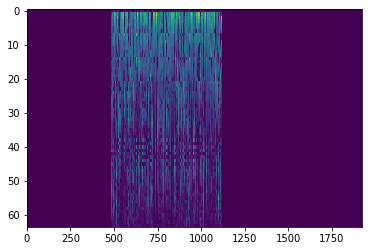

In [31]:
plt.imshow(np.absolute(evc_IT1), aspect = 'auto')

In [21]:
G_T1=nx.Graph()
G=G_T1

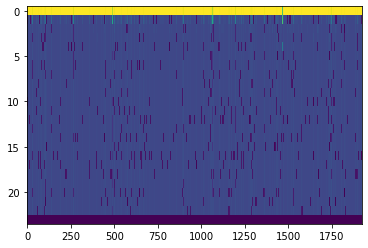

In [22]:
#t=5*160
centrality=[]
for t in range(len(plv_T1[1,1,0,:])):
    min_plv=0.2
    max_plv=0.95
    adj=plv_T1[:,:,0,t]
    G.clear()
    G.add_nodes_from(epochs.ch_names)
    pos=nx.circular_layout(G)
    for i in range(len(epochs.ch_names)-1):
        for j in range(i):
            if (adj[i,j]<=min_plv or adj[i,j]>=max_plv):
                continue
            w_edges= [(epochs.ch_names[i],epochs.ch_names[j],1-adj[i,j])]
            G.add_weighted_edges_from(w_edges)
    
    H=nx.minimum_spanning_tree(G, weight=1)
    centrality.append(nx.eigenvector_centrality(H).values())
    
lst_T1=[]
for t in centrality:
    lst_T1.append(list(t))

plt.imshow(np.transpose(lst_T1), aspect='auto')

In [23]:
len(picks)

24

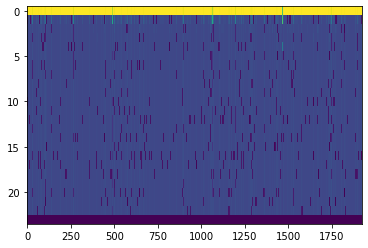

In [24]:
#t=5*160
centrality=[]
for t in range(len(plv_T2[1,1,0,:])):
    min_plv=0.2
    max_plv=0.95
    adj=plv_T2[:,:,0,t]
    G.clear()
    G.add_nodes_from(epochs.ch_names)
    pos=nx.circular_layout(G)
    for i in range(len(epochs.ch_names)-1):
        for j in range(i):
            if (adj[i,j]<=min_plv or adj[i,j]>=max_plv):
                continue
            w_edges= [(epochs.ch_names[i],epochs.ch_names[j],1-adj[i,j])]
            G.add_weighted_edges_from(w_edges)
    del H
    H=nx.minimum_spanning_tree(G, weight=1)
    centrality.append(nx.eigenvector_centrality(H).values())
    
lst_T2=[]
for t in centrality:
    lst_T2.append(list(t))
    
plt.imshow(np.transpose(lst_T1), aspect='auto')


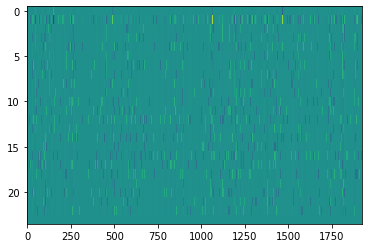

In [25]:
plt.imshow(np.transpose(np.array(lst_T1)-np.array(lst_T2)), aspect='auto')

#### computing minimum spanning tree ###Use graph H as minimum spanning tree
H=nx.minimum_spanning_tree(G, weight=1)
print(sorted(H.edges(data=True)))
nx.draw(H,pos, with_labels=True)

In [26]:
(H.edges)


EdgeView([('FC6', 'FC5'), ('FC6', 'CP2'), ('FC6', 'C3'), ('FC6', 'Fp1'), ('FC6', 'C2'), ('FC6', 'CP3'), ('FC6', 'C1'), ('FC6', 'AF3'), ('FC6', 'FC3'), ('FC6', 'Fp2'), ('FC6', 'C6'), ('FC6', 'CP5'), ('FC6', 'FC1'), ('FC6', 'AF7'), ('FC6', 'FC4'), ('FC6', 'CP6'), ('FC6', 'AF8'), ('FC6', 'C5'), ('FC6', 'C4'), ('FC6', 'CP1'), ('FC6', 'FC2'), ('FC6', 'AF4')])

for values in G.nodes:
    evc.append(centrality[values])


H=nx.minimum_spanning_tree(G, weight=1)
print(sorted(H.edges(data=True)))
nx.draw(H,pos, with_labels=True)

pos=nx.spring_layout(G)
plt.figure(figsize=(100,100))
nx.draw_networkx_edges(G,pos,alpha=0.3,width=3, edge_color='m')
nodesize=10
nx.draw_networkx_nodes(G,pos,node_size=nodesize,node_color='w',alpha=0.4)
nx.draw_networkx_edges(G,pos,alpha=0.4,node_size=0,width=1,edge_color='k')
nx.draw_networkx_labels(G,pos,fontsize=14)

In [30]:

layout = mne.find_layout(epochs.info, 'eeg')  # use full layout

tfr = mne.time_frequency.AverageTFR(epochs.info, lst_T1, times, freqs, len(lst_T1))
tfr.plot_topo(fig_facecolor='w', font_color='k', border='k')

AttributeError: 'list' object has no attribute 'ndim'